<h1><center>NFL Big Data Bowl 2021. EDA.</center></h1>

<center><img src="https://operations.nfl.com/media/3607/big-data-bowl_baked.jpg?anchor=center&mode=crop&width=1417&height=740&rnd=131956651790000000&quality=85"></center>

In [1]:
import numpy as np
import pandas as pd
        
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go

pd.set_option('display.max_columns', None)

<a id="1"></a>
<h2 style='background:black; border:0; color:white'><center>1. Game Data<center><h2>

### **Game data:** The games.csv contains the teams playing in each game. The key variable is gameId.

* **gameId:** Game identifier, unique (numeric)

* **gameDate:** Game Date (time, mm/dd/yyyy)

* **gameTimeEastern:** Start time of game (time, HH:MM:SS, EST)

* **homeTeamAbbr:** Home team three-letter code (text)

* **visitorTeamAbbr:** Visiting team three-letter code (text)

* **week:** Week of game (numeric)

In [2]:
games = pd.read_csv('/kaggle/input/nfl-big-data-bowl-2021/games.csv')
games

,gameId,gameDate,gameTimeEastern,homeTeamAbbr,visitorTeamAbbr,week
0,2018090600,09/06/2018,20:20:00,PHI,ATL,1
1,2018090901,09/09/2018,13:00:00,CLE,PIT,1
2,2018090902,09/09/2018,13:00:00,IND,CIN,1
3,2018090903,09/09/2018,13:00:00,MIA,TEN,1
4,2018090900,09/09/2018,13:00:00,BAL,BUF,1
...,...,...,...,...,...,...
248,2018123013,12/30/2018,16:25:00,DEN,LAC,17
249,2018123015,12/30/2018,16:25:00,SEA,ARI,17
250,2018123014,12/30/2018,16:25:00,LA,SF,17
251,2018122200,12/22/2018,16:30:00,TEN,WAS,16


In [3]:
check = games['gameDate'].value_counts().reset_index()
check.columns = [
    'date', 
    'games'
]
check = check.sort_values('games')

fig = px.bar(
    check, 
    y='date', 
    x="games", 
    orientation='h', 
    title='Number of games for every date', 
    height=900, 
    width=800
)

fig.show()

In [4]:
check = games['gameTimeEastern'].value_counts().reset_index()
check.columns = [
    'time', 
    'games'
]
check = check.sort_values('games')

fig = px.bar(
    check, 
    y='time', 
    x="games", 
    orientation='h', 
    title='Number of games for every time', 
    height=400, 
    width=800
)

fig.show()

In [5]:
check = games['homeTeamAbbr'].value_counts().reset_index()
check.columns = [
    'team', 
    'games'
]
check = check.sort_values('games')

fig = px.bar(
    check, 
    y='team', 
    x="games", 
    orientation='h', 
    title='Number of games for every team (home)', 
    height=700, 
    width=800
)

fig.show()

In [6]:
check = games['visitorTeamAbbr'].value_counts().reset_index()
check.columns = [
    'team', 
    'games'
]
check = check.sort_values('games')

fig = px.bar(
    check, 
    y='team', 
    x="games", 
    orientation='h', 
    title='Number of games for every team (away)', 
    height=700, 
    width=800
)

fig.show()

In [7]:
check = games['week'].value_counts().reset_index()
check.columns = [
    'week', 
    'games'
]
check = check.sort_values('games')
check['week'] = check['week'].astype(str) + '-'

fig = px.bar(
    check, 
    y='week', 
    x="games", 
    orientation='h', 
    title='Number of games for every week', 
    height=500, 
    width=800
)

fig.show()

<a id="2"></a>
<h2 style='background:black; border:0; color:white'><center>2. Player Data<center><h2>

### **Player data:** The players.csv file contains player-level information from players that participated in any of the tracking data files. The key variable is nflId

* **nflId:** Player identification number, unique across players (numeric)

* **height:** Player height (text)

* **weight:** Player weight (numeric)

* **birthDate:** Date of birth (YYYY-MM-DD)

* **collegeName:** Player college (text)

* **position:** Player position (text)

* **displayName:** Player name (text)

In [8]:
players = pd.read_csv('/kaggle/input/nfl-big-data-bowl-2021/players.csv')
players

,nflId,height,weight,birthDate,collegeName,position,displayName
0,2539334,72,190,1990-09-10,Washington,CB,Desmond Trufant
1,2539653,70,186,1988-11-01,Southeastern Louisiana,CB,Robert Alford
2,2543850,69,186,1991-12-18,Purdue,SS,Ricardo Allen
3,2555162,73,227,1994-11-04,Louisiana State,MLB,Deion Jones
4,2555255,75,232,1993-07-01,Minnesota,OLB,De'Vondre Campbell
...,...,...,...,...,...,...,...
1298,2553798,6-2,235,09/17/1991,Vanderbilt,LS,Andrew East
1299,2556814,6-2,200,05/17/1994,Duke,WR,Max McCaffrey
1300,2552576,78,231,1992-04-25,Oregon State,QB,Sean Mannion
1301,2561469,69,187,1993-03-15,Alabama-Birmingham,CB,Darious Williams


Convert all heights to feet.

In [9]:
check = players['height'].str.split('-',expand=True)
check.columns = [
    'first', 
    'second'
]

check.loc[(check['second'].notnull()), 'first'] = check[check['second'].notnull()]['first'].astype(np.int16) * 12 + check[check['second'].notnull()]['second'].astype(np.int16)

In [10]:
players['height'] = check['first']
players['height'] = players['height'].astype(np.float32)
players['height'] /= 12

players

,nflId,height,weight,birthDate,collegeName,position,displayName
0,2539334,6.000000,190,1990-09-10,Washington,CB,Desmond Trufant
1,2539653,5.833333,186,1988-11-01,Southeastern Louisiana,CB,Robert Alford
2,2543850,5.750000,186,1991-12-18,Purdue,SS,Ricardo Allen
3,2555162,6.083333,227,1994-11-04,Louisiana State,MLB,Deion Jones
4,2555255,6.250000,232,1993-07-01,Minnesota,OLB,De'Vondre Campbell
...,...,...,...,...,...,...,...
1298,2553798,6.166667,235,09/17/1991,Vanderbilt,LS,Andrew East
1299,2556814,6.166667,200,05/17/1994,Duke,WR,Max McCaffrey
1300,2552576,6.500000,231,1992-04-25,Oregon State,QB,Sean Mannion
1301,2561469,5.750000,187,1993-03-15,Alabama-Birmingham,CB,Darious Williams


In [11]:
fig = make_subplots(rows=1, cols=2)
traces = [
    go.Histogram(
        x=players[col[0]], 
        nbinsx=col[1], 
        name=col[0]
    ) for col in [('height', 20), ('weight', 50)]
]

for i in range(len(traces)):
    fig.append_trace(
        traces[i], 
        (i // 2) + 1, 
        (i % 2) + 1
    )

fig.update_layout(
    title_text='Height & weight distributions',
    height=400,
    width=800
)

fig.show()

In [12]:
check = players['collegeName'].value_counts().reset_index()
check.columns = [
    'college', 
    'players'
]
check = check.sort_values('players').tail(50)

fig = px.bar(
    check, 
    y='college', 
    x="players", 
    orientation='h', 
    title='Top 50 colleges by number of players',
    height=900,
    width=800
)

fig.show()

In [13]:
check = players['position'].value_counts().reset_index()
check.columns = [
    'position', 
    'players'
]
check = check.sort_values('players')

fig = px.bar(
    check, 
    y='position', 
    x="players", 
    orientation='h', 
    title='Top positions by number of players',
    height=600,
    width=800
)

fig.show()

### Players positions abbreviation

* WR: Wide Receiver;
* CB: Cornerback;
* RB: Running Back;
* TE: Tight End;
* OLB: Outside Linebacker;
* QB: Quarterback;
* FS: Free Safety;
* LB: Linebacker;
* SS: Strong Safety;
* ILB: Inside Linebacker;
* DE: Defensive End;
* DB: Defensive Back;
* MLB: Middle Linebacker;
* DT: Defensive Tackle;
* FB: Fullback;
* P: Punter;
* LS: Long snapper;
* S: Safety; 
* K: Kicker;
* HB: Running back;
* NT: Nose Tackle

<a id="3"></a>
<h2 style='background:black; border:0; color:white'><center>3. Play Data<center><h2>

### **Play data:** The plays.csv file contains play-level information from each game. The key variables are gameId and playId

* **gameId:** Game identifier, unique (numeric)

* **playId:** Play identifier, not unique across games (numeric)

* **playDescription:** Description of play (text)

* **quarter:** Game quarter (numeric)

* **down:** Down (numeric)

* **yardsToGo:** Distance needed for a first down (numeric)

* **possessionTeam:** Team on offense (text)

* **playType:** Outcome of dropback: sack or pass (text)

* **yardlineSide:** 3-letter team code corresponding to line-of-scrimmage (text)

* **yardlineNumber:** Yard line at line-of-scrimmage (numeric)

* **offenseFormation:** Formation used by possession team (text)

* **personnelO:** Personnel used by offensive team (text)

* **defendersInTheBox:** Number of defenders in close proximity to line-of-scrimmage (numeric)

* **numberOfPassRushers:** Number of pass rushers (numeric)

* **personnelD:** Personnel used by defensive team (text)

* **typeDropback:** Dropback categorization of quarterback (text)

* **preSnapHomeScore:** Home score prior to the play (numeric)

* **preSnapVisitorScore:** Visiting team score prior to the play (numeric)

* **gameClock:** Time on clock of play (MM:SS)

* **absoluteYardlineNumber:** Distance from end zone for possession team (numeric)

* **penaltyCodes:** NFL categorization of the penalties that ocurred on the play. For purposes of this contest, the most important penalties are Defensive Pass Interference (DPI), Offensive Pass Interference (OPI), Illegal Contact (ICT), and Defensive Holding (DH). Multiple penalties on a play are separated by a ; (text)

* **penaltyJerseyNumber:** Jersey number and team code of the player commiting each penalty. Multiple penalties on a play are separated by a ; (text)

* **passResult:** Outcome of the passing play (C: Complete pass, I: Incomplete pass, S: Quarterback sack, IN: Intercepted pass, text)

* **offensePlayResult:** Yards gained by the offense, excluding penalty yardage (numeric)

* **playResult:** Net yards gained by the offense, including penalty yardage (numeric)

* **epa:** Expected points added on the play, relative to the offensive team. Expected points is a metric that estimates the average of every next scoring outcome given the play's down, distance, yardline, and time remaining (numeric)

* **isDefensivePI:** An indicator variable for whether or not a DPI penalty ocurred on a given play (TRUE/FALSE)

In [14]:
plays = pd.read_csv('/kaggle/input/nfl-big-data-bowl-2021/plays.csv')

plays

,gameId,playId,playDescription,quarter,down,yardsToGo,possessionTeam,playType,yardlineSide,yardlineNumber,offenseFormation,personnelO,defendersInTheBox,numberOfPassRushers,personnelD,typeDropback,preSnapVisitorScore,preSnapHomeScore,gameClock,absoluteYardlineNumber,penaltyCodes,penaltyJerseyNumbers,passResult,offensePlayResult,playResult,epa,isDefensivePI
0,2018090600,75,(15:00) M.Ryan pass short right to J.Jones pus...,1,1,15,ATL,play_type_pass,ATL,20,I_FORM,"2 RB, 1 TE, 2 WR",7.0,4.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0.0,0.0,15:00:00,90.0,NaN,NaN,C,10,10,0.261827,False
1,2018090600,146,(13:10) M.Ryan pass incomplete short right to ...,1,1,10,ATL,play_type_pass,PHI,39,SINGLEBACK,"1 RB, 1 TE, 3 WR",7.0,4.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0.0,0.0,13:10:00,49.0,NaN,NaN,I,0,0,-0.372360,False
2,2018090600,168,(13:05) (Shotgun) M.Ryan pass incomplete short...,1,2,10,ATL,play_type_pass,PHI,39,SHOTGUN,"2 RB, 1 TE, 2 WR",6.0,4.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0.0,0.0,13:05:00,49.0,NaN,NaN,I,0,0,-0.702779,False
3,2018090600,190,(13:01) (Shotgun) M.Ryan pass deep left to J.J...,1,3,10,ATL,play_type_pass,PHI,39,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,5.0,"4 DL, 1 LB, 6 DB",SCRAMBLE_ROLLOUT_LEFT,0.0,0.0,13:01:00,49.0,NaN,NaN,C,33,33,3.047530,False
4,2018090600,256,(10:59) (Shotgun) M.Ryan pass incomplete short...,1,3,1,ATL,play_type_pass,PHI,1,SHOTGUN,"2 RB, 3 TE, 0 WR",8.0,6.0,"6 DL, 3 LB, 2 DB",TRADITIONAL,0.0,0.0,10:59:00,11.0,NaN,NaN,I,0,0,-0.842272,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19234,2018122200,2300,(7:53) J.Johnson pass incomplete short left [K...,3,2,5,WAS,play_type_unknown,WAS,31,SINGLEBACK,"1 RB, 1 TE, 3 WR",7.0,NaN,"2 DL, 4 LB, 5 DB",NaN,NaN,NaN,NaN,NaN,DH,TEN 24,I,0,5,0.848703,False
19235,2018122200,3177,(6:53) (Shotgun) B.Gabbert pass incomplete sho...,4,3,7,TEN,play_type_unknown,WAS,37,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,NaN,"2 DL, 4 LB, 5 DB",NaN,NaN,NaN,NaN,NaN,DH,WAS 31,I,0,5,1.227695,False
19236,2018122201,566,(5:32) (Shotgun) P.Rivers pass deep right to K...,1,3,4,LAC,play_type_unknown,LAC,49,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,NaN,"1 DL, 5 LB, 5 DB",NaN,NaN,NaN,NaN,NaN,OPI,LAC 13,C,27,-10,-0.720168,False
19237,2018122201,1719,(1:08) P.Rivers pass incomplete deep middle to...,2,3,1,LAC,play_type_unknown,LAC,48,SINGLEBACK,"1 RB, 1 TE, 3 WR",7.0,NaN,"2 DL, 3 LB, 6 DB",NaN,NaN,NaN,NaN,NaN,DPI,BAL 23,I,0,15,1.336078,True


In [15]:
check = plays['quarter'].value_counts().reset_index()
check.columns = [
    'quarter', 
    'plays'
]
check = check.sort_values('plays')

fig = px.pie(
    check, 
    names='quarter', 
    values="plays",  
    title='Number of plays of every quarter',
    height=500,
    width=800
)

fig.show()

In [16]:
check = plays['down'].value_counts().reset_index()
check.columns = [
    'down', 
    'plays'
]
check = check.sort_values('plays')

fig = px.pie(
    check, 
    names='down', 
    values="plays",  
    title='Number of plays of every down',
    height=500,
    width=800
)

fig.show()

In [17]:
check = plays['yardsToGo'].value_counts().reset_index()
check.columns = [
    'yardsToGo', 
    'plays'
]
check['yardsToGo'] = check['yardsToGo'].astype(str) + '-'
check = check.sort_values('plays')

fig = px.bar(
    check, 
    y='yardsToGo', 
    x="plays", 
    orientation='h', 
    title='Number of plays for every yards to go category',
    height=800,
    width=800
)

fig.show()

In [18]:
check = plays['possessionTeam'].value_counts().reset_index()
check.columns = [
    'team', 
    'plays'
]
check = check.sort_values('plays')

fig = px.bar(
    check, 
    y='team', 
    x="plays", 
    orientation='h', 
    title='Number of plays for every team',
    height=800,
    width=800
)

fig.show()

In [19]:
check = plays['playType'].value_counts().reset_index()
check.columns = [
    'type', 
    'plays'
]
check = check.sort_values('plays')

fig = px.pie(
    check, 
    names='type', 
    values="plays",  
    title='Number of plays of every type',
    height=500,
    width=800
)

fig.show()

In [20]:
check = plays['yardlineSide'].value_counts().reset_index()
check.columns = [
    'yardlineSide', 
    'plays'
]
check = check.sort_values('plays')

fig = px.bar(
    check, 
    y='yardlineSide', 
    x="plays", 
    orientation='h', 
    title='Number of plays for every team yard side',
    height=800,
    width=800
)

fig.show()

In [21]:
check = plays['yardlineNumber'].value_counts().reset_index()
check.columns = [
    'yardline', 
    'plays'
]
check = check.sort_values('plays')

fig = px.bar(
    check, 
    x='yardline', 
    y="plays",  
    title='Number of plays for every yardline',
    height=500,
    width=800
)

fig.show()

In [22]:
check = plays['personnelO'].value_counts().reset_index()
check.columns = [
    'personnelO', 
    'plays'
]
check = check.sort_values('plays')

fig = px.bar(
    check, 
    y='personnelO', 
    x="plays", 
    orientation='h', 
    title='Number of plays for every personnelO',
    height=1000,
    width=800
)

fig.show()

In [23]:
check = plays['offenseFormation'].value_counts().reset_index()
check.columns = [
    'offenseFormation', 
    'plays'
]
check = check.sort_values('plays')

fig = px.pie(
    check, 
    names='offenseFormation', 
    values="plays",  
    title='Number of plays for every offense formation type',
    height=500,
    width=800
)

fig.show()

In [24]:
check = plays['defendersInTheBox'].value_counts().reset_index()
check.columns = [
    'defendersInTheBox', 
    'plays'
]
check = check.sort_values('plays')

fig = px.bar(
    check, 
    x='defendersInTheBox', 
    y="plays",  
    title='Number of plays for every number of defenders in the box',
    height=500,
    width=800
)

fig.show()

In [25]:
check = plays['numberOfPassRushers'].value_counts().reset_index()
check.columns = [
    'numberOfPassRushers', 
    'plays'
]
check = check.sort_values('plays')

fig = px.bar(
    check, 
    x='numberOfPassRushers', 
    y="plays",  
    title='Number of plays for every number of pass rushers',
    height=500,
    width=800
)

fig.show()

In [26]:
fig = px.histogram(
    plays, 
    x='absoluteYardlineNumber',
    width=800,
    height=500,
    nbins=50,
    title='Absolute Yardline Number distribution'
)

fig.show()

In [27]:
check = plays['typeDropback'].value_counts().reset_index()
check.columns = [
    'typeDropback', 
    'plays'
]

check = check.sort_values('plays')

fig = px.pie(
    check, 
    names='typeDropback', 
    values="plays",  
    title='Number of plays for every Dropback type',
    height=500,
    width=800
)

fig.show()

In [28]:
check = plays['passResult'].value_counts().reset_index()
check.columns = [
    'passResult', 
    'plays'
]
check = check.sort_values('plays')

fig = px.pie(
    check, 
    names='passResult', 
    values="plays",  
    title='Number of plays for every pass result',
    height=500,
    width=800
)

fig.show()

In [29]:
fig = px.histogram(
    plays, 
    x="offensePlayResult",
    width=800,
    height=500,
    nbins=50,
    title='Offense Play result distribution'
)

fig.show()

In [30]:
fig = px.histogram(
    plays, 
    x="playResult",
    width=800,
    height=500,
    nbins=50,
    title='Play result distribution'
)

fig.show()

In [31]:
fig = px.histogram(
    plays, 
    x="preSnapVisitorScore",
    width=800,
    height=500,
    nbins=50,
    title='Pre Snap Visitor Score distribution'
)

fig.show()

In [32]:
fig = px.histogram(
    plays, 
    x="preSnapHomeScore",
    width=800,
    height=500,
    nbins=50,
    title='Pre Snap Home Score distribution'
)

fig.show()

<a id="4"></a>
<h2 style='background:black; border:0; color:white'><center>4. Tracking Data<center><h2>

### **Tracking data:** Files week[week].csv contain player tracking data from all games in week [week]. The key variables are gameId, playId, and nflId. There are 17 weeks to a typical NFL Regular Season, and thus 17 data frames with player tracking data are provided.

### Each of the 17 week[week].csv files contain player tracking data from all passing plays during Week [week] of the 2018 regular season. Nearly all plays from each [gameId] are included; certain plays or games with insufficient data are dropped. Each team and player plays no more than 1 game in a given week.

* **time:** Time stamp of play (time, yyyy-mm-dd, hh:mm:ss)

* **x:** Player position along the long axis of the field, 0 - 120 yards. See Figure 1 below. (numeric)

* **y:** Player position along the short axis of the field, 0 - 53.3 yards. See Figure 1 below. (numeric)

* **s:** Speed in yards/second (numeric)

* **a:** Acceleration in yards/second^2 (numeric)

* **dis:** Distance traveled from prior time point, in yards (numeric)

* **o:** Player orientation (deg), 0 - 360 degrees (numeric)

* **dir:** Angle of player motion (deg), 0 - 360 degrees (numeric)

* **event:** Tagged play details, including moment of ball snap, pass release, pass catch, tackle, etc (text)

* **nflId:** Player identification number, unique across players (numeric)

* **displayName:** Player name (text)

* **jerseyNumber:** Jersey number of player (numeric)

* **position:** Player position group (text)

* **team:** Team (away or home) of corresponding player (text)

* **frameId:** Frame identifier for each play, starting at 1 (numeric)

* **gameId:** Game identifier, unique (numeric)

* **playId:** Play identifier, not unique across games (numeric)

* **playDirection:** Direction that the offense is moving (text, left or right)

* **route:** Route ran by offensive player (text)

In [33]:
weeks = [
    '/kaggle/input/nfl-big-data-bowl-2021/week1.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week2.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week3.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week4.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week5.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week6.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week7.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week8.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week9.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week10.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week11.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week12.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week13.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week14.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week15.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week16.csv',
    '/kaggle/input/nfl-big-data-bowl-2021/week17.csv'
]

In [34]:
week_dfs = list()
for week in weeks:
    week_dfs.append(pd.read_csv(week))
weeks = pd.concat(week_dfs)

weeks

,time,x,y,s,a,dis,o,dir,event,nflId,displayName,jerseyNumber,position,frameId,team,gameId,playId,playDirection,route
0,2018-09-07T01:07:14.599Z,91.73,26.67,0.00,0.01,0.02,289.57,240.93,None,310.0,Matt Ryan,2.0,QB,1,away,2018090600,75,left,NaN
1,2018-09-07T01:07:14.599Z,88.89,36.47,0.01,0.01,0.01,105.63,66.66,None,79848.0,Malcolm Jenkins,27.0,SS,1,home,2018090600,75,left,NaN
2,2018-09-07T01:07:14.599Z,91.35,44.16,0.02,0.03,0.01,290.45,16.86,None,2495454.0,Julio Jones,11.0,WR,1,away,2018090600,75,left,HITCH
3,2018-09-07T01:07:14.599Z,86.31,22.01,0.09,0.42,0.01,70.12,168.91,None,2495613.0,Corey Graham,24.0,FS,1,home,2018090600,75,left,NaN
4,2018-09-07T01:07:14.599Z,90.78,36.15,0.00,0.00,0.00,257.61,193.97,None,2533040.0,Mohamed Sanu,12.0,WR,1,away,2018090600,75,left,HITCH
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1049260,2018-12-31T04:23:24.200Z,95.77,11.20,7.15,1.75,0.73,103.97,118.54,None,2558942.0,Anthony Firkser,86.0,TE,102,home,2018123011,4261,left,POST
1049261,2018-12-31T04:23:24.200Z,101.94,14.60,5.63,2.24,0.57,139.23,119.97,None,2558976.0,Kenny Moore,23.0,CB,102,away,2018123011,4261,left,NaN
1049262,2018-12-31T04:23:24.200Z,102.68,0.94,2.34,1.67,0.24,164.79,152.29,None,2560789.0,Darius Leonard,53.0,LB,102,away,2018123011,4261,left,NaN
1049263,2018-12-31T04:23:24.200Z,105.82,0.71,2.28,3.53,0.25,284.72,93.44,None,2561521.0,Cameron Batson,17.0,WR,102,home,2018123011,4261,left,OUT


In [35]:
fig = px.histogram(
    weeks.head(1000000), 
    x="x",
    width=800,
    height=500,
    nbins=50,
    title='X coordinate distribution'
)

fig.show()

In [36]:
fig = px.histogram(
    weeks.head(1000000), 
    x="y",
    width=800,
    height=500,
    nbins=50,
    title='Y coordinate distribution'
)

fig.show()

In [37]:
fig = px.histogram(
    weeks.head(1000000), 
    x="s",
    width=800,
    height=500,
    nbins=50,
    title='Speed distribution'
)

fig.show()

In [38]:
fig = px.histogram(
    weeks.head(1000000), 
    x="a",
    width=800,
    height=500,
    nbins=50,
    title='Acceleration distribution'
)

fig.show()

In [39]:
fig = px.histogram(
    weeks.head(1000000), 
    x="dis",
    width=800,
    height=500,
    nbins=50,
    title='Distance distribution (yards)'
)

fig.show()

In [40]:
fig = px.histogram(
    weeks.head(1000000), 
    x="o",
    width=800,
    height=500,
    nbins=50,
    title='Player orientation distribution'
)

fig.show()

In [41]:
fig = px.histogram(
    weeks.head(1000000), 
    x="dir",
    width=800,
    height=500,
    nbins=50,
    title='Angle of player motion distribution'
)

fig.show()

In [42]:
check = weeks[weeks['event'] != 'None']
check = check['event'].value_counts().reset_index()
check.columns = ['event', 'actions']
check = check.sort_values('actions')

fig = px.bar(
    check, 
    y='event', 
    x="actions", 
    orientation='h', 
    title='Not none events',
    height=1000,
    width=800
)

fig.show()

In [43]:
check = weeks['jerseyNumber'].value_counts().reset_index()
check.columns = [
    'jerseyNumber', 
    'items'
]
check['jerseyNumber'] = check['jerseyNumber'].astype(np.int16).astype(str) + '-'
check = check.sort_values('items')

fig = px.bar(
    check, 
    y='jerseyNumber', 
    x="items", 
    orientation='h', 
    title='Most popular jerseys',
    height=1500,
    width=800
)

fig.show()

Do all games have the near the same number of events?

In [44]:
check = weeks['gameId'].value_counts().reset_index()
check.columns = [
    'gameId', 
    'items'
]
check['gameId'] = check['gameId'].astype(np.int64).astype(str) + '-'
check = check.sort_values('items')

fig = px.bar(
    check, 
    y='gameId', 
    x="items", 
    orientation='h', 
    title='Number for events for every game',
    height=1500,
    width=800
)

fig.show()

<a id="5"></a>
<h2 style='background:black; border:0; color:white'><center>5. Football field visualization<center><h2>

For plays analysis I will use football field visualization shared in  <a href="https://www.kaggle.com/robikscube/nfl-big-data-bowl-plotting-player-position">this perfect kernel by @robikscube</a>

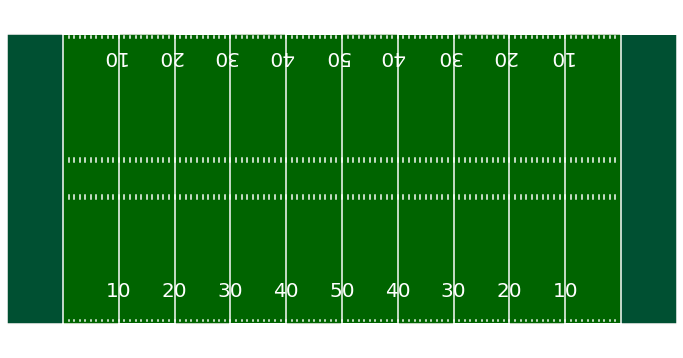

In [45]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def create_football_field(
    linenumbers=True,
    endzones=True,
    highlight_line=False,
    highlight_line_number=50,
    highlighted_name='Line of Scrimmage',
    fifty_is_los=False,
    figsize=(12, 6.33)
):

    rect = patches.Rectangle((0, 0), 120, 53.3, linewidth=0.1, edgecolor='r', facecolor='darkgreen', zorder=0)

    fig, ax = plt.subplots(1, figsize=figsize)
    ax.add_patch(rect)

    plt.plot([10, 10, 10, 20, 20, 30, 30, 40, 40, 50, 50, 60, 60, 70, 70, 80,
              80, 90, 90, 100, 100, 110, 110, 120, 0, 0, 120, 120],
             [0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3,
              53.3, 0, 0, 53.3, 53.3, 0, 0, 53.3, 53.3, 53.3, 0, 0, 53.3],
             color='white')
    if fifty_is_los:
        plt.plot([60, 60], [0, 53.3], color='gold')
        plt.text(62, 50, '<- Player Yardline at Snap', color='gold')
 
    if endzones:
        ez1 = patches.Rectangle((0, 0), 10, 53.3,
                                linewidth=0.1,
                                edgecolor='r',
                                facecolor='blue',
                                alpha=0.2,
                                zorder=0)
        ez2 = patches.Rectangle((110, 0), 120, 53.3,
                                linewidth=0.1,
                                edgecolor='r',
                                facecolor='blue',
                                alpha=0.2,
                                zorder=0)
        ax.add_patch(ez1)
        ax.add_patch(ez2)
    plt.xlim(0, 120)
    plt.ylim(-5, 58.3)
    plt.axis('off')
    if linenumbers:
        for x in range(20, 110, 10):
            numb = x
            if x > 50:
                numb = 120 - x
            plt.text(x, 5, str(numb - 10),
                     horizontalalignment='center',
                     fontsize=20,  # fontname='Arial',
                     color='white')
            plt.text(x - 0.95, 53.3 - 5, str(numb - 10),
                     horizontalalignment='center',
                     fontsize=20,  # fontname='Arial',
                     color='white', rotation=180)
    if endzones:
        hash_range = range(11, 110)
    else:
        hash_range = range(1, 120)

    for x in hash_range:
        ax.plot([x, x], [0.4, 0.7], color='white')
        ax.plot([x, x], [53.0, 52.5], color='white')
        ax.plot([x, x], [22.91, 23.57], color='white')
        ax.plot([x, x], [29.73, 30.39], color='white')

    if highlight_line:
        hl = highlight_line_number + 10
        plt.plot([hl, hl], [0, 53.3], color='yellow')
        plt.text(hl + 2, 50, '<- {}'.format(highlighted_name),
                 color='yellow')
    return fig, ax

create_football_field()
plt.show()

### Work in progress